In [160]:
import librosa
from pathlib import Path
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import IPython.display as ipd
%matplotlib inline

In [2]:
df = pd.read_pickle('../data/taylor_df.pkl')

In [3]:
df.head()

,name,song_wave,scene_start_times_sec,onset_times_sec
0,Taylor Swift - White Horse-D1Xr-JFLxik,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0 0.000 1 0.667 2 3.587 3...,"[0.6965986394557823, 1.3467573696145125, 1.648..."
1,Taylor Swift - The Story Of Us-nN6VR92V70M,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0 0.000 1 0.500 2 1.417 3...,"[0.6501587301587302, 0.905578231292517, 1.0913..."
2,Taylor Swift - Delicate-tCXGJQYZ9JA,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0 0.000 1 3.045 2 6.715 3 ...,"[3.8312925170068026, 4.040272108843538, 4.2028..."
3,Taylor Swift - Style--CmadmM5cOk,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0 0.000 1 7.424 2 9.259 3...,"[0.11609977324263039, 10.077460317460318, 10.4..."
4,Taylor Swift - ME! (feat. Brendon Urie of Pani...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0 0.000 1 0.500 2 5.255 3 ...,"[17.29886621315193, 19.11002267573696, 19.6208..."


In [5]:
song = df.loc[0]

In [7]:
start_times_samples = librosa.time_to_samples(song.scene_start_times_sec)

In [14]:
# skip start of first scene in index 0
scenes = np.split(song.song_wave, start_times_samples[1:])

In [16]:
scenes_per_song = df.apply(lambda song: np.split(song.song_wave, librosa.time_to_samples(song.scene_start_times_sec[1:])), axis=1)

In [18]:
scenes_per_song[0]

[array([0.        , 0.        , 0.        , ..., 0.0006107 , 0.00194227,
        0.00204345], dtype=float32),
 array([ 0.00258181,  0.00321789, -0.00042781, ..., -0.00345409,
        -0.0040898 , -0.00516588], dtype=float32),
 array([-0.00549056, -0.00651792, -0.00709362, ...,  0.00641602,
         0.00297485, -0.00108282], dtype=float32),
 array([-0.00171745, -0.0003967 , -0.00208408, ...,  0.00531817,
         0.0045549 ,  0.00334034], dtype=float32),
 array([0.00183634, 0.00049643, 0.00040514, ..., 0.02013852, 0.02037555,
        0.01786017], dtype=float32),
 array([ 0.01525851,  0.01402924,  0.01237203, ...,  0.00298373,
        -0.00115581, -0.0046421 ], dtype=float32),
 array([-0.00814795, -0.00837469, -0.00894558, ..., -0.03848026,
        -0.04082411, -0.03802798], dtype=float32),
 array([-0.04024351, -0.03839885, -0.0359698 , ..., -0.03264109,
        -0.0267601 , -0.02023532], dtype=float32),
 array([-0.02814046, -0.02261337, -0.02056454, ...,  0.01100009,
         0.01495042

In [21]:
scenes_per_song.values

[[array([0.        , 0.        , 0.        , ..., 0.0006107 , 0.00194227,
         0.00204345], dtype=float32),
  array([ 0.00258181,  0.00321789, -0.00042781, ..., -0.00345409,
         -0.0040898 , -0.00516588], dtype=float32),
  array([-0.00549056, -0.00651792, -0.00709362, ...,  0.00641602,
          0.00297485, -0.00108282], dtype=float32),
  array([-0.00171745, -0.0003967 , -0.00208408, ...,  0.00531817,
          0.0045549 ,  0.00334034], dtype=float32),
  array([0.00183634, 0.00049643, 0.00040514, ..., 0.02013852, 0.02037555,
         0.01786017], dtype=float32),
  array([ 0.01525851,  0.01402924,  0.01237203, ...,  0.00298373,
         -0.00115581, -0.0046421 ], dtype=float32),
  array([-0.00814795, -0.00837469, -0.00894558, ..., -0.03848026,
         -0.04082411, -0.03802798], dtype=float32),
  array([-0.04024351, -0.03839885, -0.0359698 , ..., -0.03264109,
         -0.0267601 , -0.02023532], dtype=float32),
  array([-0.02814046, -0.02261337, -0.02056454, ...,  0.01100009,
  

In [24]:
all_segments = sum(scenes_per_song.values, [])

In [25]:
len(all_segments)

3758

In [46]:
dir(df.loc[0])

['T',
 '_AXIS_ALIASES',
 '_AXIS_IALIASES',
 '_AXIS_LEN',
 '_AXIS_NAMES',
 '_AXIS_NUMBERS',
 '_AXIS_ORDERS',
 '_AXIS_REVERSED',
 '_AXIS_SLICEMAP',
 '__abs__',
 '__add__',
 '__and__',
 '__array__',
 '__array_prepare__',
 '__array_priority__',
 '__array_wrap__',
 '__bool__',
 '__bytes__',
 '__class__',
 '__contains__',
 '__copy__',
 '__deepcopy__',
 '__delattr__',
 '__delitem__',
 '__dict__',
 '__dir__',
 '__div__',
 '__divmod__',
 '__doc__',
 '__eq__',
 '__finalize__',
 '__float__',
 '__floordiv__',
 '__format__',
 '__ge__',
 '__getattr__',
 '__getattribute__',
 '__getitem__',
 '__getstate__',
 '__gt__',
 '__hash__',
 '__iadd__',
 '__iand__',
 '__ifloordiv__',
 '__imod__',
 '__imul__',
 '__init__',
 '__init_subclass__',
 '__int__',
 '__invert__',
 '__ior__',
 '__ipow__',
 '__isub__',
 '__iter__',
 '__itruediv__',
 '__ixor__',
 '__le__',
 '__len__',
 '__long__',
 '__lt__',
 '__matmul__',
 '__mod__',
 '__module__',
 '__mul__',
 '__ne__',
 '__neg__',
 '__new__',
 '__nonzero__',
 '__or__',
 

In [47]:
df.apply(lambda s: s['name'], axis=1).head(5)

0               Taylor Swift - White Horse-D1Xr-JFLxik
1           Taylor Swift - The Story Of Us-nN6VR92V70M
2                  Taylor Swift - Delicate-tCXGJQYZ9JA
3                     Taylor Swift - Style--CmadmM5cOk
4    Taylor Swift - ME! (feat. Brendon Urie of Pani...
dtype: object

In [49]:
all_song_names

0     [Taylor Swift - White Horse-D1Xr-JFLxik, Taylo...
1     [Taylor Swift - The Story Of Us-nN6VR92V70M, T...
2     [Taylor Swift - Delicate-tCXGJQYZ9JA, Taylor S...
3     [Taylor Swift - Style--CmadmM5cOk, Taylor Swif...
4     [Taylor Swift - ME! (feat. Brendon Urie of Pan...
5     [Taylor Swift - Mine-XPBwXKgDTdE, Taylor Swift...
6     [Taylor Swift - Out Of The Woods-JLf9q36UsBk, ...
7     [Taylor Swift - Mean-jYa1eI1hpDE, Taylor Swift...
8     [Taylor Swift - Fearless-ptSjNWnzpjg, Taylor S...
9     [Taylor Swift - …Ready For It-wIft-t-MQuE, Tay...
10    [Taylor Swift - We Are Never Ever Getting Back...
11    [Taylor Swift - You Need To Calm Down-Dkk9gvTm...
12    [Taylor Swift - Look What You Made Me Do-3tmd-...
13    [Taylor Swift - Blank Space-e-ORhEE9VVg, Taylo...
14    [Taylor Swift - 22-AgFeZr5ptV8, Taylor Swift -...
15    [Taylor Swift - Sparks Fly-oKar-tF__ac, Taylor...
16    [Taylor Swift - I Knew You Were Trouble-vNoKgu...
17    [Taylor Swift - You Belong With Me-VuNIsY6

In [50]:
all_song_names = df.apply(lambda song: [song['name']] * len(song.scene_start_times_sec), axis=1)
all_song_names = np.concatenate(all_song_names)

In [74]:
index_in_song = np.concatenate(df.apply(lambda song: list(range(len(song.scene_start_times_sec))), axis=1))

In [75]:
segments['index_in_song'] = index_in_song

In [51]:
segments = pd.DataFrame({'segment' : all_segments, 'name' : all_song_names, 'index_in_song' : index_in_song})
segments.head()

In [170]:
segments.to_pickle('song_segments.pkl')

In [53]:
# calculate onsetiness
onset_strengths = segments.segment.apply(librosa.onset.onset_strength)
onset_strengths.head(3)

0    [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...
1    [0.0, 0.0, 0.0, 0.55870104, 0.30338454, 0.3912...
2    [0.0, 0.0, 0.0, 0.5821059, 0.40556344, 0.49901...
Name: segment, dtype: object

In [55]:
# add onsetiness column
segments["onset_envelope"] = onset_strengths

In [56]:
segments.head(3)

,segment,name,onset_envelope
0,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",Taylor Swift - White Horse-D1Xr-JFLxik,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
1,"[0.0025818117, 0.0032178853, -0.00042781193, -...",Taylor Swift - White Horse-D1Xr-JFLxik,"[0.0, 0.0, 0.0, 0.55870104, 0.30338454, 0.3912..."
2,"[-0.0054905606, -0.0065179174, -0.007093623, -...",Taylor Swift - White Horse-D1Xr-JFLxik,"[0.0, 0.0, 0.0, 0.5821059, 0.40556344, 0.49901..."


In [58]:
target_song, _ = librosa.load('../data/movies/Arctic Monkeys - Do I Wanna Know (Official Video)-bpOSxM0rNPM/Arctic Monkeys - Do I Wanna Know (Official Video)-bpOSxM0rNPM.webm')

In [59]:
target_onset_envelope = librosa.onset.onset_strength(target_song)

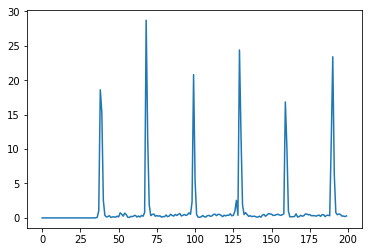

In [162]:
plt.plot(target_onset_envelope[:200])

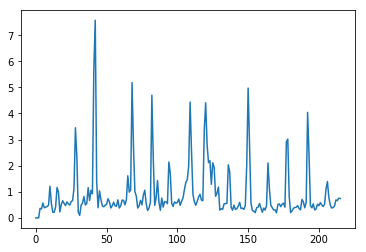

In [165]:
plt.plot(segments.loc[3].onset_envelope)

In [166]:
len(segments.loc[3].onset_envelope)

216

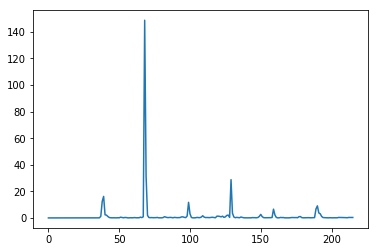

In [168]:
plt.plot(target_onset_envelope[:216] * segments.loc[3].onset_envelope)

In [118]:
onset_silly_match = segments.onset_envelope.map(lambda section: np.sum(np.dot(section, target_onset_envelope[:len(section)])) / len(section)**0.75)

In [119]:
onset_silly_match

0        0.000000
1        3.694280
2        5.363503
3        6.230438
4        3.374994
5        3.845097
6        5.214833
7        2.814297
8        5.516216
9        7.071215
10       4.575574
11      10.219750
12       3.773435
13       2.874799
14       2.020700
15       2.732284
16       6.171294
17       2.374453
18       3.748724
19       1.567973
20       4.985716
21       5.347902
22       1.559727
23       2.261317
24       1.047965
25       4.719693
26       6.344580
27       1.815580
28       3.031809
29       2.377785
          ...    
3728     1.915794
3729     1.597589
3730     1.920854
3731     0.000000
3732     2.001109
3733     0.059323
3734     1.598355
3735     0.000000
3736     0.000000
3737     1.662042
3738     1.724663
3739     0.000000
3740     0.000000
3741     0.000000
3742     0.000000
3743     0.000918
3744     1.324372
3745     0.000000
3746     1.708807
3747     1.674846
3748     1.133820
3749     2.119224
3750     4.934229
3751     3.773946
3752     2

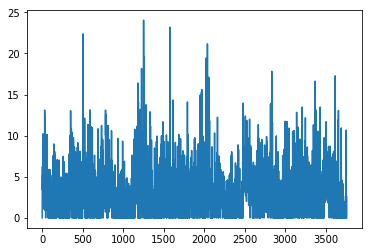

In [120]:
onset_silly_match.plot()

In [121]:
best_match_index = onset_silly_match.idxmax()

In [122]:
best_match = segments.loc[best_match_index]
best_match

segment           [-0.16981381, -0.18903561, -0.19228783, -0.174...
name               Taylor Swift - You Need To Calm Down-Dkk9gvTmCXY
onset_envelope    [0.0, 0.0, 0.0, 0.6448337, 0.22572932, 0.74479...
index_in_song                                                    34
Name: 1252, dtype: object

In [123]:
matching_song = df[df['name'] == best_match['name']]
matching_song

,name,song_wave,scene_start_times_sec,onset_times_sec
11,Taylor Swift - You Need To Calm Down-Dkk9gvTmCXY,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0 0.000 1 0.500 2 2.836 3 ...,"[0.5572789115646258, 0.7430385487528345, 1.277..."


In [124]:
matching_song.scene_start_times_sec.values[0]

0       0.000
1       0.500
2       2.836
3       5.589
4       8.383
5      10.844
6      14.097
7      19.686
8      21.897
9      24.942
10     26.818
11     32.157
12     34.159
13     40.874
14     42.334
15     43.752
16     45.170
17     52.219
18     56.014
19     61.603
20     63.188
21     64.773
22     65.899
23     69.319
24     71.321
25     73.407
26     75.325
27     76.994
28     77.744
29     78.495
       ...   
70    162.204
71    164.414
72    165.040
73    167.250
74    168.835
75    170.837
76    173.465
77    175.634
78    176.259
79    177.386
80    179.262
81    180.597
82    181.515
83    182.516
84    183.141
85    183.767
86    184.684
87    185.769
88    187.020
89    189.106
90    190.399
91    191.817
92    193.402
93    194.611
94    195.237
95    195.862
96    196.780
97    197.531
98    198.156
99    204.955
Name: Start Time (seconds), Length: 100, dtype: float64

In [125]:
wave = matching_song.song_wave.values[0]
start_times = matching_song.scene_start_times_sec.values[0]
start_time = start_times[best_match.index_in_song]
# TODO: end of song if index_in_song is the last one
end_time = start_times[best_match.index_in_song + 1]
start_sample = librosa.time_to_samples(start_time)
end_sample = librosa.time_to_samples(end_time)

In [115]:
ipd.Audio(wave[start_sample:end_sample], rate=22050)

In [116]:
ipd.Audio(target_song[:end_sample-start_sample], rate=22050)

In [126]:
ipd.Audio(np.stack([wave[start_sample:end_sample],target_song[:end_sample-start_sample]]), rate=22050)

In [153]:
def silly_segment_matcher(target_segment):
    def silly_match(seg):
        min_length = min(len(seg), len(target_segment))
        # original clip was with power 0.5
        return np.sum(np.dot(seg[:min_length], target_segment[:min_length])) / min_length**0.75
    return silly_match

def build_song_segments(target_song, segments_df, songs_df):
    matches = []
    wave_segments = []
    target_remaining_samples = target_song
    while len(target_remaining_samples) > 10000:
        # TODO: only necessary to calculate onsets up to max length of segment, not entire remaining song
        # fix if too slow
        target_onset_envelope = librosa.onset.onset_strength(target_remaining_samples)
        # dot prod - correlate segments, penalize by sqrt of length, which makes longer segments better
        onset_silly_match = segments_df.onset_envelope.map(silly_segment_matcher(target_onset_envelope))
        best_match_index = onset_silly_match.idxmax()
        best_match = segments_df.loc[best_match_index]
        matching_song = songs_df[songs_df['name'] == best_match['name']]
        wave = matching_song.song_wave.values[0]
        start_times = matching_song.scene_start_times_sec.values[0]
        start_time = start_times[best_match.index_in_song]
        # end of song if index_in_song is the last one
        end_time = start_times[best_match.index_in_song + 1] if best_match.index_in_song + 1 < len(start_times) \
                    else librosa.samples_to_time(len(wave))
        start_sample = librosa.time_to_samples(start_time)
        end_sample = librosa.time_to_samples(end_time)
        
        matches.append((best_match['name'], start_time, end_time))
        consumed_samples = end_sample - start_sample
        target_remaining_samples = target_remaining_samples[consumed_samples:]
        # don't reuse samples
        segments_df = segments_df.drop(best_match_index)
        wave_segments.append(wave[start_sample : end_sample])
    return matches, np.concatenate(wave_segments)

In [154]:
matches, stitched_wave = build_song_segments(target_song, segments, df)

In [144]:
len(stitched_wave), len(target_song)

(5938155, 5858448)

In [146]:
ipd.Audio(np.stack([target_song[:len(stitched_wave)], stitched_wave[:len(target_song)]]), rate=22050)

In [155]:
matches

[('Taylor Swift - You Need To Calm Down-Dkk9gvTmCXY', 85.294, 87.337),
 ('Taylor Swift - You Need To Calm Down-Dkk9gvTmCXY', 75.325, 76.994),
 ('Taylor Swift - You Need To Calm Down-Dkk9gvTmCXY', 76.994, 77.744),
 ('Taylor Swift - Blank Space-e-ORhEE9VVg', 9.384, 10.26),
 ('Taylor Swift - Look What You Made Me Do-3tmd-ClpJxA', 80.455, 81.081),
 ('Taylor Swift - You Need To Calm Down-Dkk9gvTmCXY',
  78.495,
  79.24600000000001),
 ('Taylor Swift - Fearless-ptSjNWnzpjg', 9.885, 10.51),
 ('Taylor Swift - I Knew You Were Trouble-vNoKguSdy4Y',
  125.959,
  126.87700000000001),
 ('Taylor Swift - You Need To Calm Down-Dkk9gvTmCXY', 32.157, 34.159),
 ('Taylor Swift - I Knew You Were Trouble-vNoKguSdy4Y', 203.578, 217.551),
 ('Taylor Swift - I Knew You Were Trouble-vNoKguSdy4Y', 124.583, 125.959),
 ('Taylor Swift - We Are Never Ever Getting Back Together-WA4iX5D9Z64',
  6.59,
  42.918),
 ('Taylor Swift - Shake It Off-nfWlot6h_JM', 0.0, 0.292),
 ('Taylor Swift - You Need To Calm Down-Dkk9gvTmCXY'

In [156]:
names, starts, ends = list(zip(*matches))

In [157]:
song_stitch_df = pd.DataFrame({'name': names, 'start': starts, 'end': ends})
song_stitch_df

,name,start,end
0,Taylor Swift - You Need To Calm Down-Dkk9gvTmCXY,85.294,87.337
1,Taylor Swift - You Need To Calm Down-Dkk9gvTmCXY,75.325,76.994
2,Taylor Swift - You Need To Calm Down-Dkk9gvTmCXY,76.994,77.744
3,Taylor Swift - Blank Space-e-ORhEE9VVg,9.384,10.260
4,Taylor Swift - Look What You Made Me Do-3tmd-C...,80.455,81.081
5,Taylor Swift - You Need To Calm Down-Dkk9gvTmCXY,78.495,79.246
6,Taylor Swift - Fearless-ptSjNWnzpjg,9.885,10.510
7,Taylor Swift - I Knew You Were Trouble-vNoKguS...,125.959,126.877
8,Taylor Swift - You Need To Calm Down-Dkk9gvTmCXY,32.157,34.159
9,Taylor Swift - I Knew You Were Trouble-vNoKguS...,203.578,217.551


In [158]:
song_stitch_df.to_pickle('arcticmonkeys2.pkl')